In [3]:
from data import plot_slices, mosmed_dataloaders
import torch
import matplotlib.pyplot as plt
import numpy as np

from pathlib import Path
fold = 1
model_file = f'model/seg_{fold}.pth'

from model import Unet3d, NonLocalSE
from seg_model import UNet3dLite
start_epoch = 0
metrics = {}

In [6]:
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')

In [7]:
if Path(model_file).exists():
    model = NonLocalSE().to(device)
    ckpt = torch.load(model_file)
    model.load_state_dict(ckpt['model'])

In [8]:
train_loader, val_loader = mosmed_dataloaders(6, 8, val_split=.2, kfold = True, only_mask_samples = True)[4]

100%|██████████| 50/50 [00:00<00:00, 99.63it/s]
/home/autobot/hmanikan/env/lib/python3.8/site-packages/sklearn/model_selection/_split.py:293: FutureWarning: Setting a random_state has no effect since shuffle is False. This will raise an error in 0.24. You should leave random_state to its default (None), or set shuffle=True.
  warnings.warn(


In [9]:
def plot_slices(n_rows, n_cols, width, height, data, filename = 'figs/file.png', mask_color = [138,43,226]):
    # data = np.rot90(data, k = 1, axes = (0, 1))
    fig_width = 12.0
    fig_height = 12.0 / (n_cols * width) * (n_rows * height)

    fig, ax = plt.subplots(n_rows, n_cols, figsize = (fig_width, fig_height), dpi = 250)

    for i in range(n_rows):
        for j in range(n_cols):
            stacked_img = data[i, j, :, :, :]
            ax[i,j].imshow(stacked_img)
            ax[i,j].axis('off')

    plt.subplots_adjust(wspace=0, hspace=0, left=0, right=1, bottom=0, top=1)
    plt.savefig(filename)

In [10]:
import cv2
import pdb

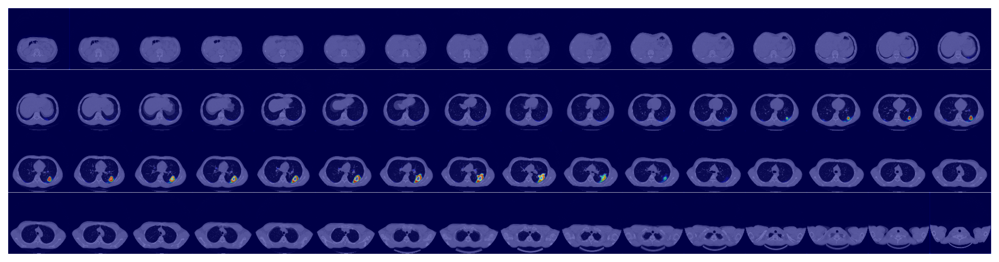

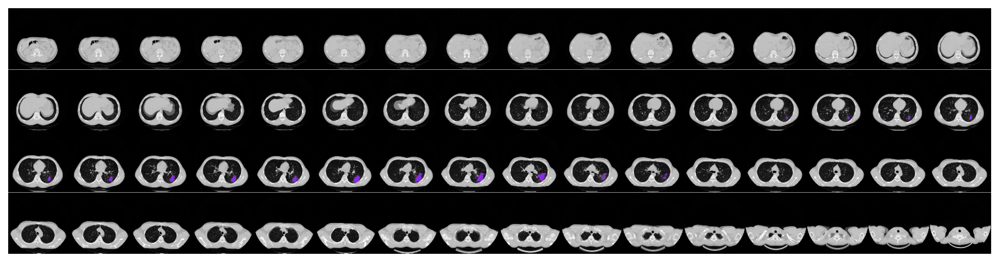

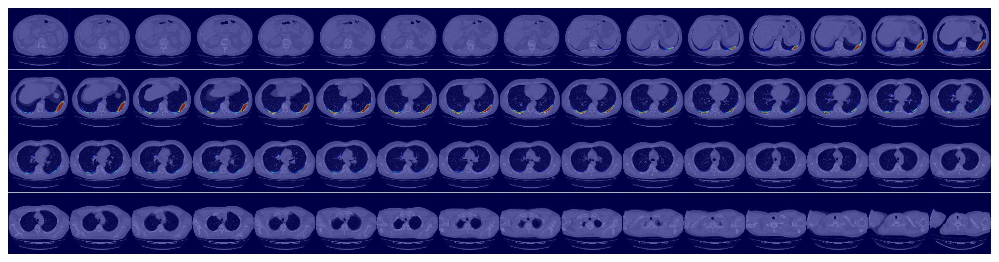

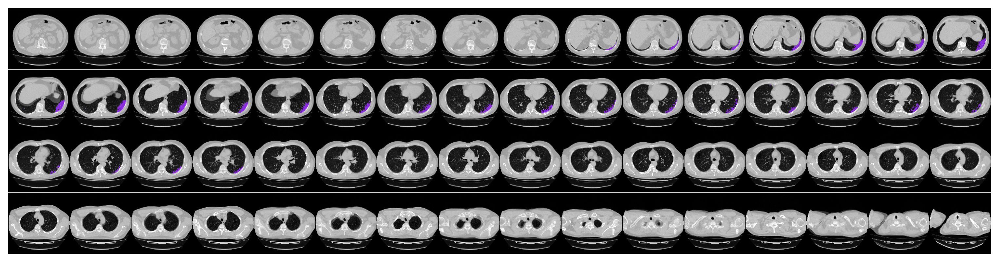

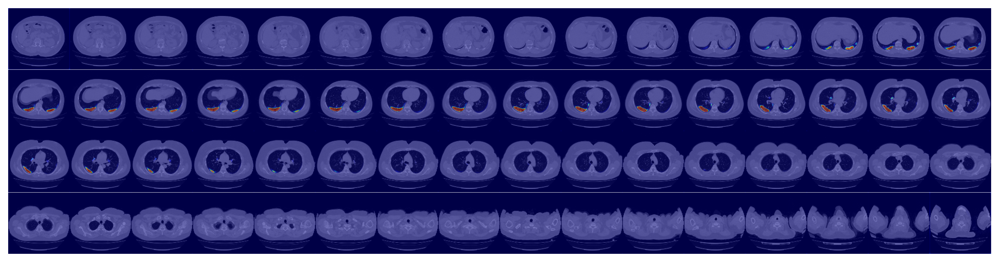

...

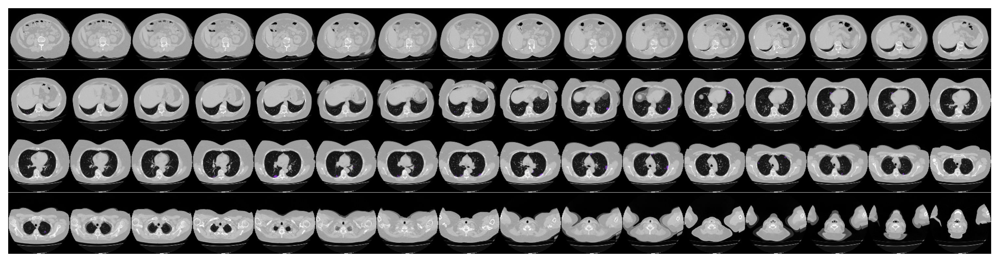

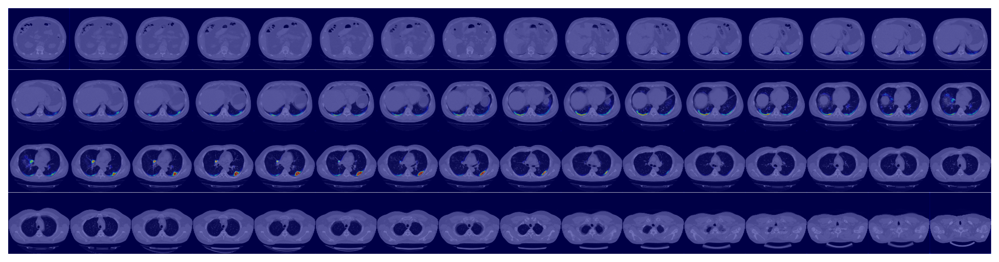

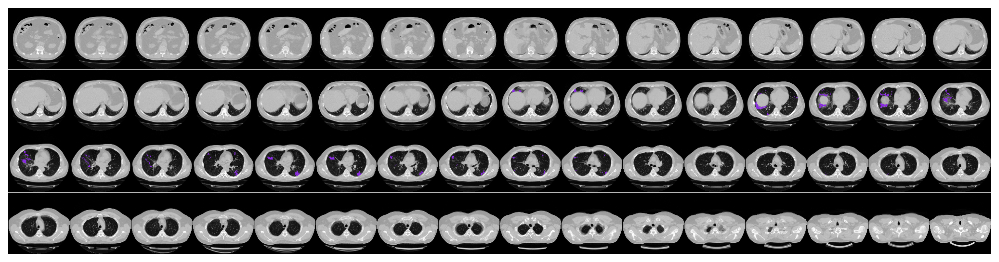

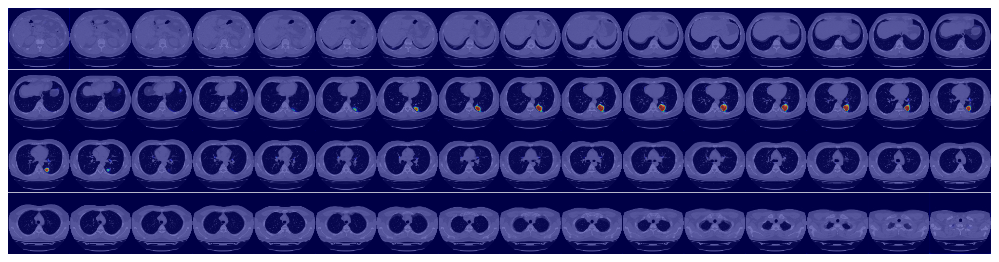

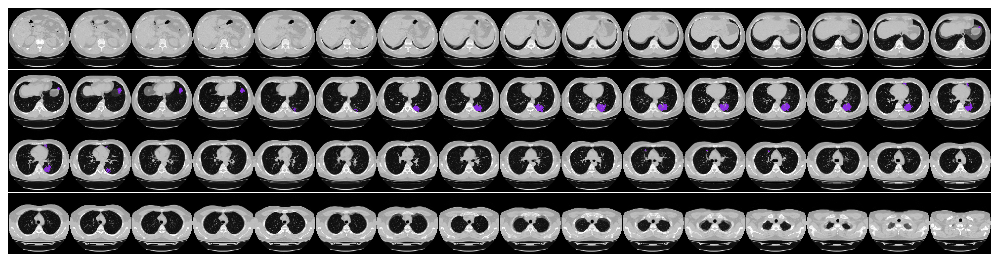

In [12]:
n_rows = 4
n_cols = 16

mask_color = [138,43,226]

for index, (processed_scan, processed_mask, score, has_mask) in enumerate(train_loader):
    scan = processed_scan.permute(0, -1, 1, 2).unsqueeze(1).type(torch.float32).to(device)
    with torch.no_grad():
        pred = model(scan)[:,0].detach().cpu()
    scan = scan[:, 0].detach().cpu() # batch x slice x height x width
    pred # batch x slice x height x width
    
    processed_mask = torch.where(processed_mask > .5, 1, 0)
    
    for sample in range(len(scan)):
        heatmaps = []
        masks = []
        scanned = np.uint8(scan* 255)
        predicted = np.uint8(pred*255)
        for sliceno in range(64):
            scan_slice = scanned[sample, sliceno, :, :]
            scan_slice = cv2.cvtColor(scan_slice,cv2.COLOR_GRAY2RGB)  # 128 x 128
            pred_slice = predicted[sample, sliceno, :, :]
            heatmap_img = cv2.applyColorMap(255- pred_slice, cv2.COLORMAP_JET)
            fin = cv2.addWeighted(scan_slice, 0.45, heatmap_img, 0.55, 0)
            heatmaps.append(fin)
            
            for i in range(128):
                for j in range(128):
                    if processed_mask[sample, i, j, sliceno]==1:
                        scan_slice[i, j] = mask_color
            masks.append(scan_slice)
        heatmap_stack = np.stack(heatmaps, axis = 0)
        masks_stack = np.stack(masks, axis = 0)

        plot_slices(n_rows, n_cols, 128, 128, heatmap_stack.reshape(n_rows, n_cols, 128, 128, 3), filename = f'savedir/real{index}_{sample}.png')
        plot_slices(n_rows, n_cols, 128, 128, masks_stack.reshape(n_rows, n_cols, 128, 128, 3), filename = f'savedir/pred{index}_{sample}.png')

        del heatmap_stack, masks_stack
        
        torch.cuda.empty_cache()

    break

In [6]:
pred.shape

torch.Size([6, 1, 64, 128, 128])

In [11]:
scan.shape

torch.Size([6, 1, 64, 128, 128])

In [10]:
pred[0].shape

torch.Size([1, 64, 128, 128])

In [7]:
processed_scan.shape

torch.Size([6, 128, 128, 64])